In [2]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import anndata as ad
import os

#from gprofiler import gprofiler

import warnings
#from rpy2.rinterface import RRuntimeWarning
#from rpy2.robjects import pandas2ri


/home/chengennong/tools/mambaforge/envs/velo/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/chengennong/tools/mambaforge/envs/velo/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/chengennong/tools/mambaforge/envs/velo/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_hdf from `anndata` is deprecated. Import anndata.io.read_hdf instead.
  warnings.warn(msg, FutureWarning)
/home/chengennong/tools/mambaforge/envs/velo/lib/python3.12/site-packages/anndata/utils.py:429: FutureWarning: Importing read_loom from `anndata` is deprecated. Import anndata.io.read_loom instead.
  warnings.warn(msg, FutureWarning)
/home/chengennong/tools/mambaforge/envs/velo/lib/python3.12/site-p

In [ ]:
#directory_A = '/mnt/data/DISCO'
#file_dict = {}
#
#for filename in os.listdir(directory_A):
#    if filename.endswith('.t.h5ad'):
#        cleaned_string = filename.replace("t.h5ad","")
#        key = cleaned_string
#        file_dict[key] = filename
#
#print(file_dict)

{'thymus.': 'thymus.t.h5ad', 'bladder.': 'bladder.t.h5ad', 'blood.': 'blood.t.h5ad', 'adipose_cell.': 'adipose_cell.t.h5ad'}


In [ ]:
#samples = file_dict
#adatas = {}
#
#for sample_id, filename in samples.items():
#    path = directory_A + "/" + filename
#    #print(sample_id + path)
#    adata = sc.read_h5ad(path)
#    adata.var_names_make_unique()
#    adatas[sample_id] = adata

In [ ]:
#adata = ad.concat(adatas, join="outer")
#print(adata.obs["tissue"].value_counts())
#adata

tissue
thymus     418947
adipose    190492
blood      169686
bladder     40520
Name: count, dtype: int64


AnnData object with n_obs × n_vars = 819645 × 33538
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'nCount_RNA', 'nFeature_RNA', 'cell_type', 'sample_id', 'project_id', 'sample_type', 'tissue', 'disease', 'platform', 'age_group', 'cell_sorting', 'subject_id', 'age', 'gender', 'rna_source', 'race', 'other_metadata', 'disease_subtype', 'time_point', 'infection', 'disease_stage', 'genotype', 'anatomical_site', 'treatment'
    obsm: 'X_X_pca', 'X_X_umap'

In [ ]:
#adata.obs['tissue'].cat.categories


Index(['adipose', 'bladder', 'blood', 'thymus'], dtype='object')

In [12]:
sc.set_figure_params(vector_friendly=True, color_map='Reds',
                     dpi=200,transparent=True, fontsize=14)

In [13]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

# BM

In [3]:
#read in all datasets
adata_bm=sc.read("/mnt/data/DISCO/bone_marrow.t.h5ad")
#adata=anndata.read("/mnt/data/DISCO/kidney.h5ad")


In [4]:
adata_bm

AnnData object with n_obs × n_vars = 421775 × 33538
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'nCount_RNA', 'nFeature_RNA', 'cell_type', 'sample_id', 'project_id', 'sample_type', 'tissue', 'disease', 'platform', 'age_group', 'cell_sorting', 'subject_id', 'age', 'gender', 'rna_source'
    var: 'gene', 'varm.PCs.V1', 'varm.PCs.V2', 'varm.PCs.V3', 'varm.PCs.V4', 'varm.PCs.V5', 'varm.PCs.V6', 'varm.PCs.V7', 'varm.PCs.V8', 'varm.PCs.V9', 'varm.PCs.V10', 'varm.PCs.V11', 'varm.PCs.V12', 'varm.PCs.V13', 'varm.PCs.V14', 'varm.PCs.V15', 'varm.PCs.V16', 'varm.PCs.V17', 'varm.PCs.V18', 'varm.PCs.V19', 'varm.PCs.V20', 'varm.PCs.V21', 'varm.PCs.V22', 'varm.PCs.V23', 'varm.PCs.V24', 'varm.PCs.V25', 'varm.PCs.V26', 'varm.PCs.V27', 'varm.PCs.V28', 'varm.PCs.V29', 'varm.PCs.V30'
    obsm: 'X_X_pca', 'X_X_umap'

In [5]:
adata_bm.obsm['X_umap'] = adata_bm.obsm['X_X_umap'] 

In [6]:

from adjustText import adjust_text
def gen_mpl_labels(
    adata, groupby, exclude=(), ax=None, adjust_kwargs=None, text_kwargs=None
):
    if adjust_kwargs is None:
        adjust_kwargs = {"text_from_points": False}
    if text_kwargs is None:
        text_kwargs = {}

    medians = {}

    for g, g_idx in adata.obs.groupby(groupby).groups.items():
        if g in exclude:
            continue
        medians[g] = np.median(adata[g_idx].obsm["X_umap"], axis=0)

    if ax is None:
        texts = [
            plt.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()
        ]
    else:
        texts = [ax.text(x=x, y=y, s=k, **text_kwargs) for k, (x, y) in medians.items()]

    adjust_text(texts, **adjust_kwargs)


In [7]:
adata_bm.obs["cell_type"]

AAACCTGAGGATTCGG-1--GSM5415745    Memory CD4 T cell
AAACCTGCACGGTAAG-1--GSM5415745     Naive CD8 T cell
AAACCTGGTCATCCCT-1--GSM5415745     Naive CD4 T cell
AAACCTGTCACAGTAC-1--GSM5415745     Naive CD4 T cell
AAACGGGTCCGCGGTA-1--GSM5415745     Naive CD8 T cell
                                        ...        
TTTGGTTGTATAAACG-1--ERX4327600    Cycling proB cell
TTTGGTTTCACCTCGT-1--ERX4327600    Cycling proB cell
TTTGTCAAGTAGCGGT-1--ERX4327600      Myeloid pre-pDC
TTTGTCACAATGGAAT-1--ERX4327600    Cycling preB cell
TTTGTCACACAGGTTT-1--ERX4327600           Osteoclast
Name: cell_type, Length: 421775, dtype: object

In [8]:
paired_colors_bm = [
    '#85a5b6',    '#8dafc1',    '#95b9cc',    '#9ec4d8',    '#a6cee3',    '#196090',    '#1a6699',
    '#1c6ca2',    '#1d72ab',    '#1f78b4',    '#8eb26e',    '#97be75',    '#a0c97c',    '#a9d483',
    '#b2df8a',    '#298023',    '#2b8825',    '#2e9028',    '#30982a',    '#33a02c',    '#c97b7a',
    '#d58382',    '#e28b8a',    '#ee9291',    '#fb9a99',    '#b61516',    '#c11618',    '#cc1719',
    '#d8191b',    '#e31a1c',    '#ca9959',    '#d7a25e',    '#e4ac64',    '#f0b569',    '#fdbf6f',
    '#cc6600',    '#d96c00',    '#e67200',    '#f27900',    '#ff7f00',    '#a28eab',    '#ac97b6',
    '#b6a0c1',    '#c0a9cb',    '#cab2d6',    '#55317b',    '#5a3483',    '#5f378b',    '#653a92',
    '#6a3d9a',    '#cccc7a',    '#d9d982',    '#e6e68a',    '#f2f291',
]
adata_bm.uns['cell_type_colors']=paired_colors_bm

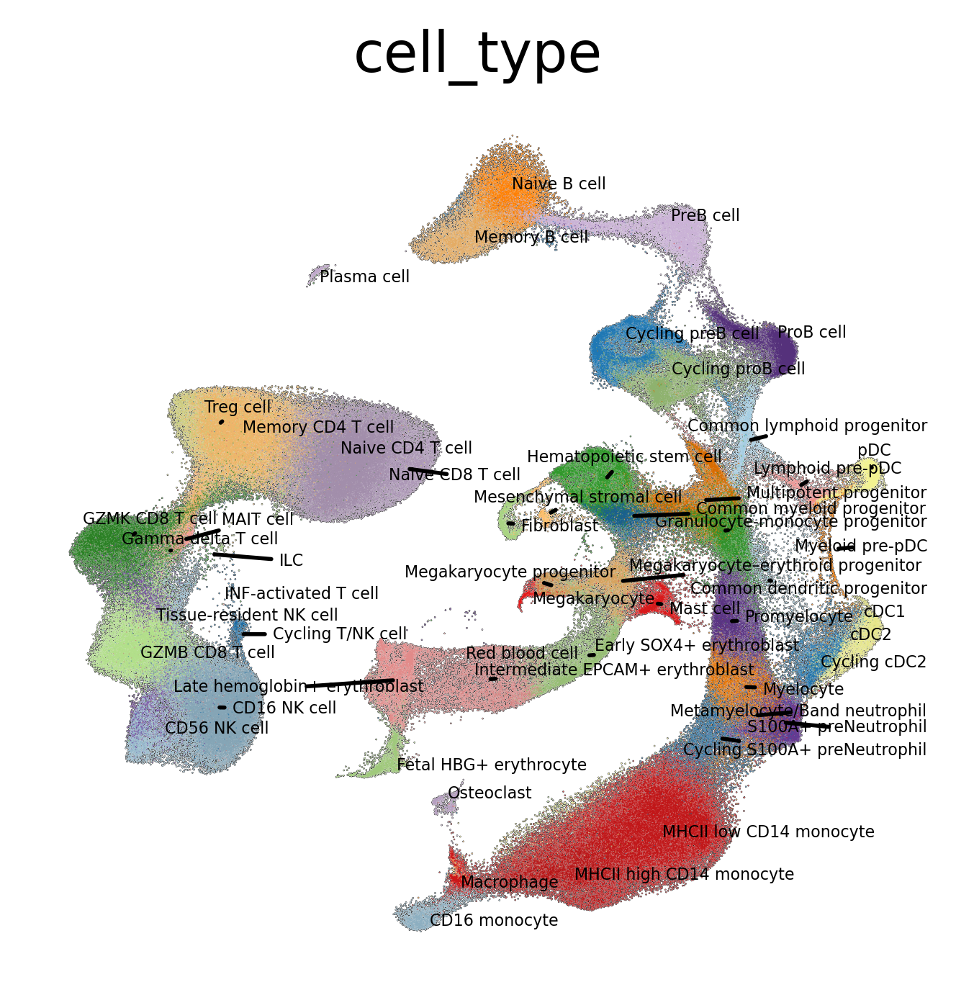

In [27]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(4, 4))
sc.pl.umap(adata_bm, color="cell_type", show=False, ax=ax,#legend_fontsize='4',
           legend_loc=None,add_outline=True, legend_fontweight = "normal",
           frameon=False)
gen_mpl_labels(
    adata_bm,
    "cell_type",
    exclude=("None",),  # This was before we had the `nan` behaviour
    ax=ax,
    adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
    text_kwargs=dict(fontsize=4),
)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/bm_cell_type.pdf",dpi=500)

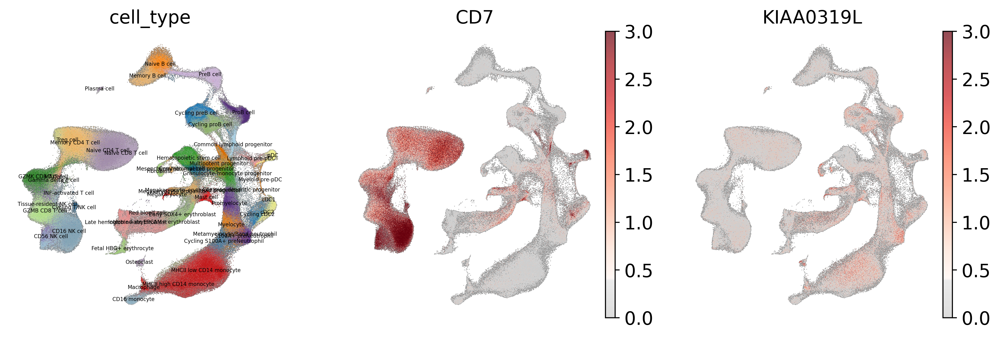

In [29]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(13, 4))
sc.pl.umap(adata_bm, color="cell_type", show=False, ax=axes[0],legend_fontsize='4',
           legend_loc="on data",add_outline=True, legend_fontweight = "normal",
           frameon=False)
sc.pl.umap(adata_bm, color=['CD7'], add_outline=True, show=False,ax=axes[1],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
sc.pl.umap(adata_bm, color=['KIAA0319L'], add_outline=True, show=False,ax=axes[2],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
#adata_thymus, color=["cell_type"]
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/bm.pdf",dpi=500)

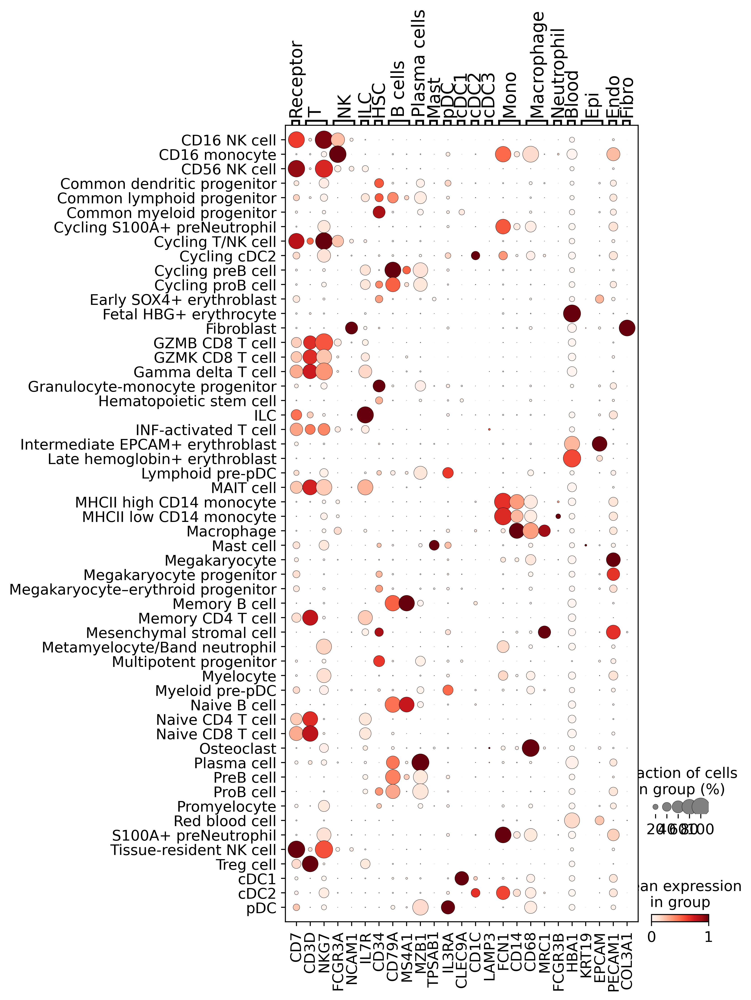

In [89]:
marker_genes = {
    "Receptor": ["CD7"],
    #"Immune": ["PTPRC"],
    "T" : ["CD3D","NKG7"],
    "NK": ["FCGR3A","NCAM1"],
    "ILC":["IL7R"],
    "HSC":["CD34"],
    "B cells": ["CD79A","MS4A1"],
    "Plasma cells": ["MZB1"],
    "Mast" : ["TPSAB1"],
    "pDC": ["IL3RA"],
    "cDC1": ["CLEC9A"],
    "cDC2": ["CD1C"],
    "cDC3": ["LAMP3"],
    "Mono": ["FCN1", "CD14"],
    "Macrophage": ["CD68", "MRC1"],
    "Neutrophil": ["FCGR3B"],
    "Blood": ["HBA1"],
    "Epi": ["KRT19", "EPCAM"],
    "Endo": ["PECAM1"],
    "Fibro": ["COL3A1"],
}
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 12.2))
sc.pl.dotplot(adata_bm, marker_genes, groupby="cell_type", standard_scale="var",use_raw=False, ax = ax, show = False)#,dendrogram=True)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/bm_dot.pdf")

# Thymus

In [30]:
#read in all datasets
adata_thymus=sc.read("/mnt/data/DISCO/thymus.t.h5ad")
#adata=anndata.read("/mnt/data/DISCO/kidney.h5ad")


In [31]:
adata_thymus

AnnData object with n_obs × n_vars = 418947 × 33538
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'nCount_RNA', 'nFeature_RNA', 'cell_type', 'sample_id', 'project_id', 'sample_type', 'tissue', 'disease', 'platform', 'age_group', 'cell_sorting', 'subject_id', 'age', 'gender', 'rna_source'
    var: 'gene', 'varm.PCs.V1', 'varm.PCs.V2', 'varm.PCs.V3', 'varm.PCs.V4', 'varm.PCs.V5', 'varm.PCs.V6', 'varm.PCs.V7', 'varm.PCs.V8', 'varm.PCs.V9', 'varm.PCs.V10', 'varm.PCs.V11', 'varm.PCs.V12', 'varm.PCs.V13', 'varm.PCs.V14', 'varm.PCs.V15', 'varm.PCs.V16', 'varm.PCs.V17', 'varm.PCs.V18', 'varm.PCs.V19', 'varm.PCs.V20', 'varm.PCs.V21', 'varm.PCs.V22', 'varm.PCs.V23', 'varm.PCs.V24', 'varm.PCs.V25', 'varm.PCs.V26', 'varm.PCs.V27', 'varm.PCs.V28', 'varm.PCs.V29', 'varm.PCs.V30'
    obsm: 'X_X_pca', 'X_X_umap'

In [32]:
adata_thymus.obsm['X_umap'] = adata_thymus.obsm['X_X_umap'] 

In [33]:
adata_thymus.obs["cell_type"]

AAACCTGAGCGTAATA-1--ERX3806095          Agonist T cell
AAACCTGAGTACGCGA-1--ERX3806095    Cycling DN/DP T cell
AAACCTGGTACATGTC-1--ERX3806095    Cycling DN/DP T cell
AAACCTGGTAGCTCCG-1--ERX3806095        Naive CD4 T cell
AAACCTGGTGCCTTGG-1--ERX3806095    Cycling DN/DP T cell
                                          ...         
TTTGGTTGTGGGTATG-1--GSM4634462                  B cell
TTTGGTTGTGGTAACG-1--GSM4634462                  B cell
TTTGTCACAACTGCTA-1--GSM4634462                  B cell
TTTGTCACACGAGGTA-1--GSM4634462                  B cell
TTTGTCAGTGGACGAT-1--GSM4634462                  B cell
Name: cell_type, Length: 418947, dtype: object

In [34]:
paired_colors_thymus = [
    '#85a5b6',    '#90b3c5',    '#9bc0d4',    '#a6cee3',    '#196090',    '#1b689c',    '#1d70a8',
    '#1f78b4',    '#8eb26e',    '#9ac178',    '#a6d081',    '#b2df8a',    '#298023',    '#2c8b26',
    '#309529',    '#33a02c',    '#c97b7a',    '#da8585',    '#ea908f',    '#fb9a99',    '#b61516',
    '#c51718',    '#d4181a',    '#e31a1c',    '#ca9959',    '#dba660',    '#ecb268',    '#fdbf6f',
    '#cc6600',    '#dd6e00',    '#ee7700',    '#ff7f00',    '#a28eab',    '#af9ab9',    '#bda6c8',
    '#cab2d6',    '#55317b',    '#5c3585',    '#633990',    '#6a3d9a',    '#cccc7a',    '#dddd85',
    '#eeee8f',    '#ffff99',    '#8e4720',    '#994d23',    '#a55325',    '#b15928',
]

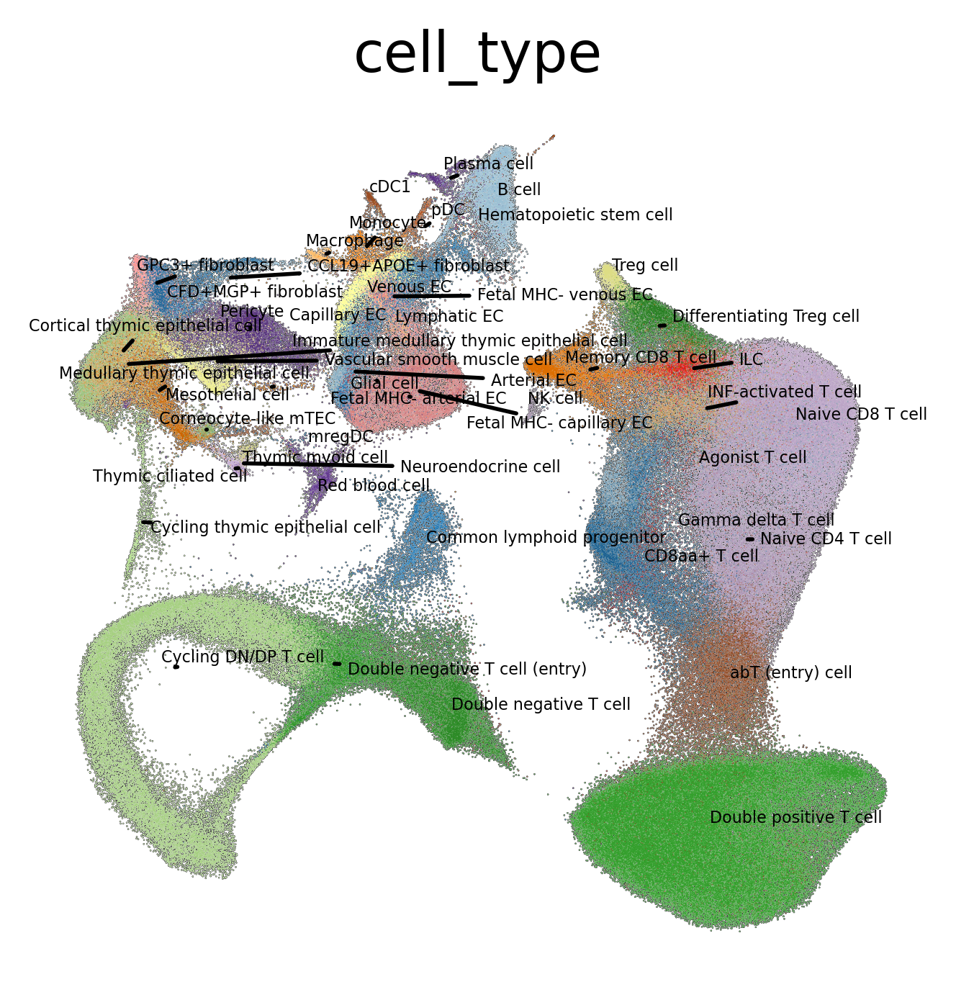

In [ ]:
ax = sc.pl.umap(adata_thymus, color="cell_type", show=False, #legend_fontsize='4',
                legend_loc=None,add_outline=True, legend_fontweight = "normal",palette=paired_colors_thymus,
                frameon=False)
gen_mpl_labels(
    adata_thymus,
    "cell_type",
    exclude=("None",),  # This was before we had the `nan` behaviour
    ax=ax,
    adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
    text_kwargs=dict(fontsize=4),
)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/thymus_cell_type.pdf",dpi=500)

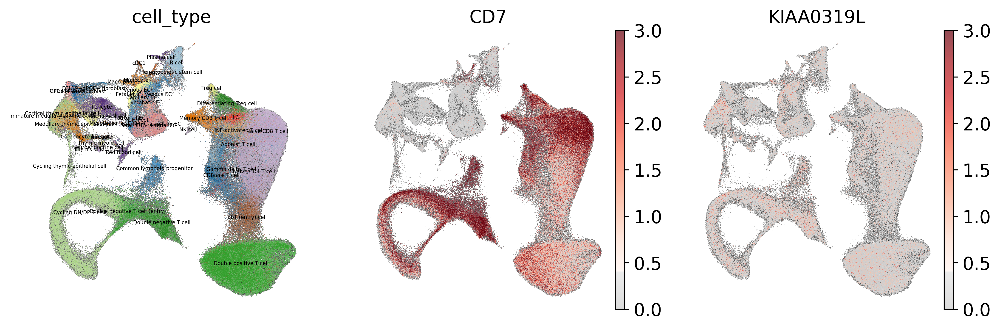

In [46]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(13, 4))
sc.pl.umap(adata_thymus, color="cell_type", show=False, legend_fontsize='4',ax=axes[0],
           legend_loc="on data",add_outline=True, legend_fontweight = "normal",palette=paired_colors_thymus,
           frameon=False)
sc.pl.umap(adata_thymus, color=['CD7'], add_outline=True, show=False,ax=axes[1],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
sc.pl.umap(adata_thymus, color=['KIAA0319L'], add_outline=True, show=False,ax=axes[2],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
#adata_thymus, color=["cell_type"]
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/thymus.pdf",dpi=500)

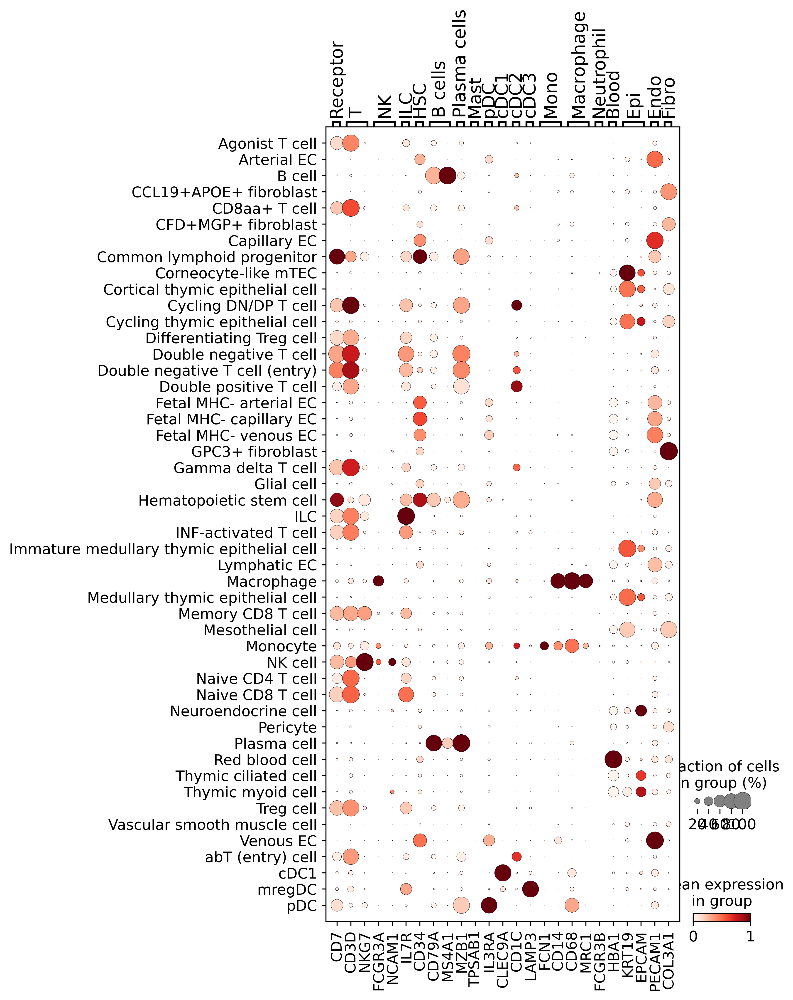

In [88]:
marker_genes = {
    "Receptor": ["CD7"],
    #"Immune": ["PTPRC"],
    "T" : ["CD3D","NKG7"],
    "NK": ["FCGR3A","NCAM1"],
    "ILC":["IL7R"],
    "HSC":["CD34"],
    "B cells": ["CD79A","MS4A1"],
    "Plasma cells": ["MZB1"],
    "Mast" : ["TPSAB1"],
    "pDC": ["IL3RA"],
    "cDC1": ["CLEC9A"],
    "cDC2": ["CD1C"],
    "cDC3": ["LAMP3"],
    "Mono": ["FCN1", "CD14"],
    "Macrophage": ["CD68", "MRC1"],
    "Neutrophil": ["FCGR3B"],
    "Blood": ["HBA1"],
    "Epi": ["KRT19", "EPCAM"],
    "Endo": ["PECAM1"],
    "Fibro": ["COL3A1"],
}
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6, 12.2))
sc.pl.dotplot(adata_thymus, marker_genes, groupby="cell_type", standard_scale="var",use_raw=False, ax = ax, show = False)#,dendrogram=True)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/thymus_dot.pdf")

# Brain

In [39]:
#read in all datasets
adata_brain=sc.read("/mnt/data/DISCO/brain.t.h5ad")
#adata=anndata.read("/mnt/data/DISCO/kidney.h5ad")


In [40]:
adata_brain

AnnData object with n_obs × n_vars = 285669 × 33538
    obs: 'orig.ident', 'nCount_originalexp', 'nFeature_originalexp', 'nCount_RNA', 'nFeature_RNA', 'cell_type', 'sample_id', 'project_id', 'sample_type', 'tissue', 'anatomical_site', 'disease', 'platform', 'subject_id', 'age', 'gender', 'race', 'batch', 'rna_source', 'other_metadata'
    var: 'gene', 'varm.PCs.V1', 'varm.PCs.V2', 'varm.PCs.V3', 'varm.PCs.V4', 'varm.PCs.V5', 'varm.PCs.V6', 'varm.PCs.V7', 'varm.PCs.V8', 'varm.PCs.V9', 'varm.PCs.V10', 'varm.PCs.V11', 'varm.PCs.V12', 'varm.PCs.V13', 'varm.PCs.V14', 'varm.PCs.V15', 'varm.PCs.V16', 'varm.PCs.V17', 'varm.PCs.V18', 'varm.PCs.V19', 'varm.PCs.V20', 'varm.PCs.V21', 'varm.PCs.V22', 'varm.PCs.V23', 'varm.PCs.V24', 'varm.PCs.V25', 'varm.PCs.V26', 'varm.PCs.V27', 'varm.PCs.V28', 'varm.PCs.V29', 'varm.PCs.V30'
    obsm: 'X_X_pca', 'X_X_umap'

In [41]:
adata_brain.obsm['X_umap'] = adata_brain.obsm['X_X_umap'] 

In [42]:
adata_brain.obs["cell_type"].value_counts().size

21

In [43]:
paired_colors_brain = [
    '#85a5b6',    '#a6cee3',    '#196090',    '#1f78b4',    '#8eb26e',    '#b2df8a',    '#298023',
    '#33a02c',    '#c97b7a',    '#fb9a99',    '#b61516',    '#e31a1c',    '#ca9959',    '#fdbf6f',
    '#cc6600',    '#ff7f00',    '#a28eab',    '#cab2d6',    '#55317b',    '#6a3d9a',    '#cccc7a',
]
adata_brain.uns['cell_type_colors']=paired_colors_brain

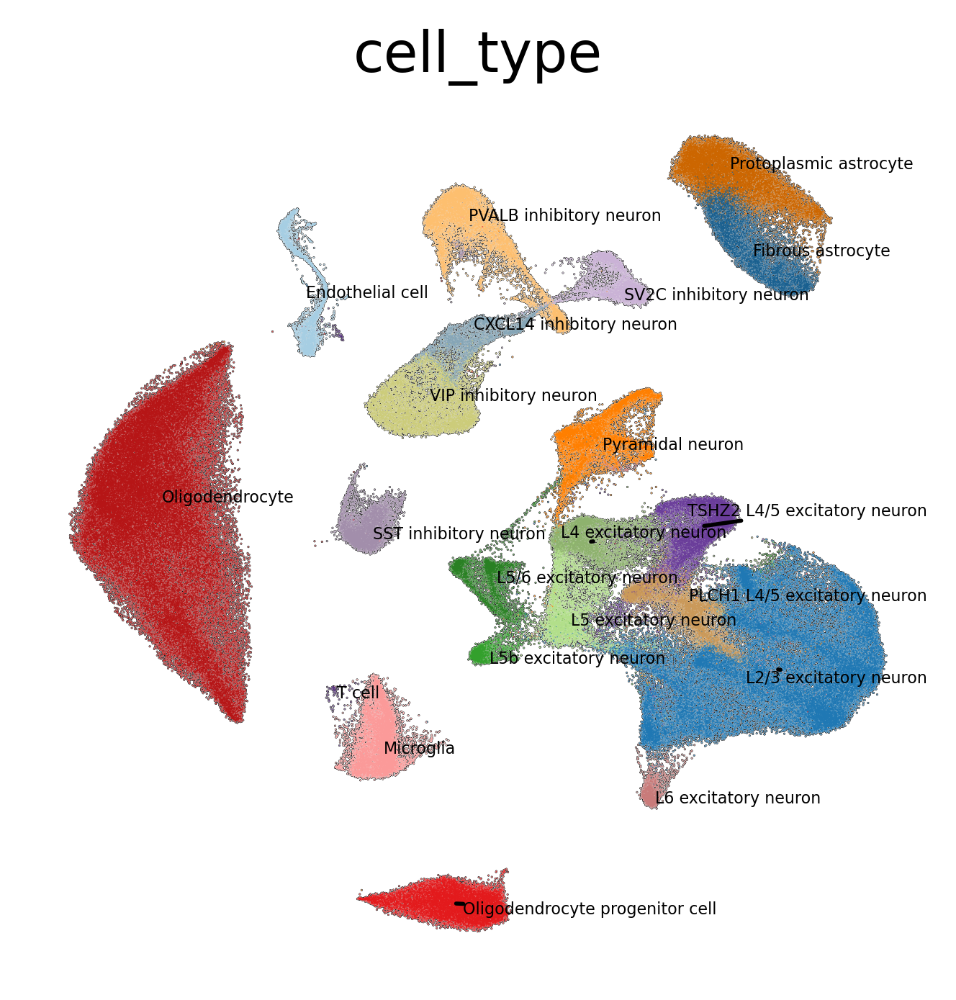

In [44]:
ax = sc.pl.umap(adata_brain, color="cell_type", show=False, #legend_fontsize='4',
                legend_loc=None,add_outline=True, legend_fontweight = "normal",
                frameon=False)
gen_mpl_labels(
    adata_brain,
    "cell_type",
    exclude=("None",),  # This was before we had the `nan` behaviour
    ax=ax,
    adjust_kwargs=dict(arrowprops=dict(arrowstyle='-', color='black')),
    text_kwargs=dict(fontsize=4),
)

plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/brain_cell_type.pdf",dpi=500)

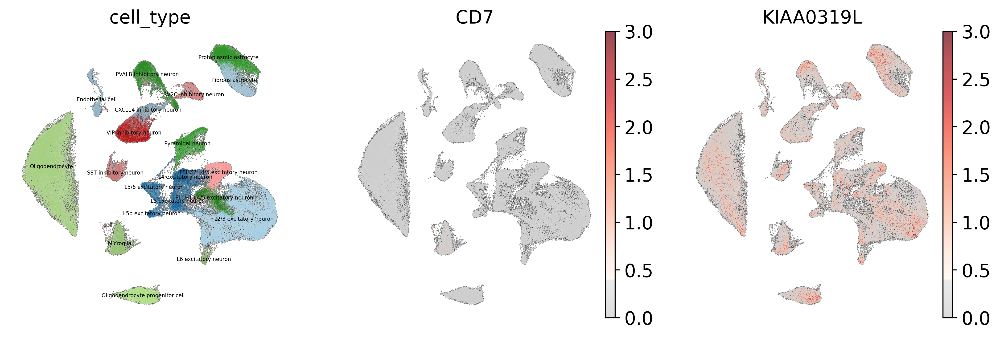

In [53]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(13, 4))
sc.pl.umap(adata_brain, color="cell_type", show=False, legend_fontsize='4',ax=axes[0],
           legend_loc="on data",add_outline=True, legend_fontweight = "normal",palette=paired_colors_thymus,
           frameon=False)
sc.pl.umap(adata_brain, color=['CD7'], add_outline=True, show=False,ax=axes[1],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
sc.pl.umap(adata_brain, color=['KIAA0319L'], add_outline=True, show=False,ax=axes[2],
           use_raw=False, wspace=0.5, legend_fontsize='x-small',frameon=False, vmax=3,color_map=mymap)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/brain.pdf",dpi=500)

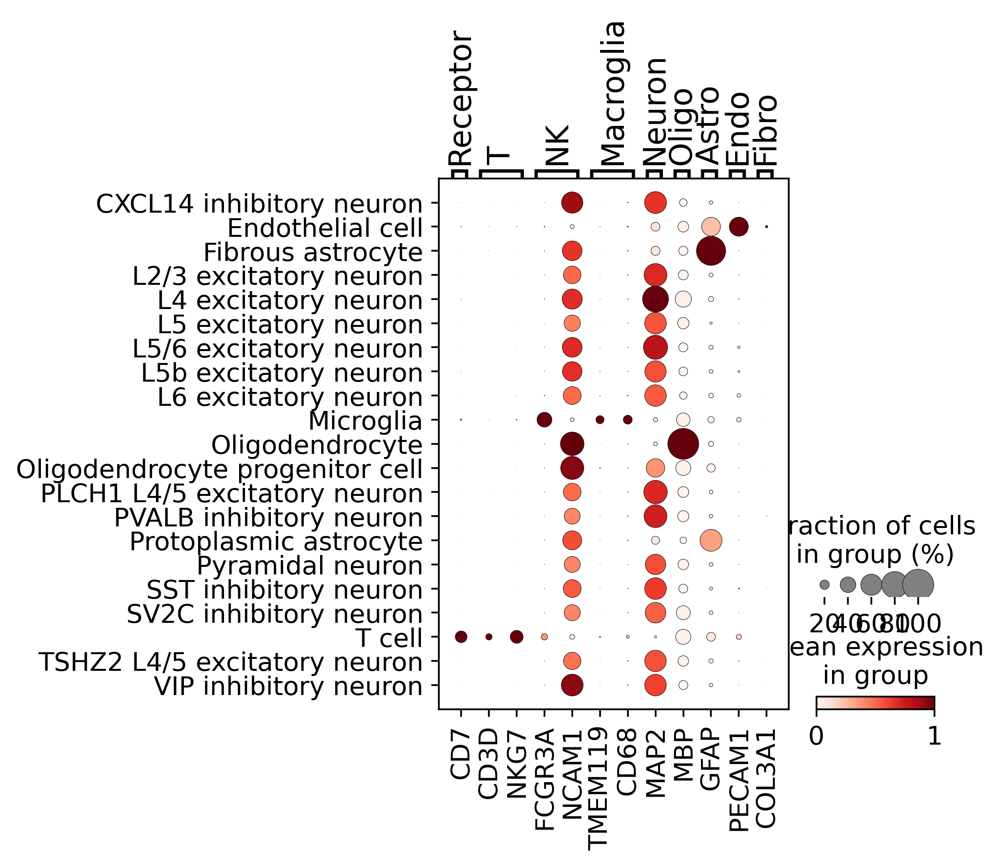

In [85]:
marker_genes = {
    "Receptor": ["CD7"],
    #"Immune": ["PTPRC"],
    "T" : ["CD3D","NKG7"],
    "NK": ["FCGR3A","NCAM1"],
    "Macroglia":["TMEM119","CD68"],
    "Neuron":["MAP2"],
    "Oligo": ["MBP"],
    "Astro": ["GFAP"],
    "Endo": ["PECAM1"],
    "Fibro": ["COL3A1"],
}
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(4, 5))
sc.pl.dotplot(adata_brain, marker_genes, groupby="cell_type", standard_scale="var",use_raw=False, ax = ax, show = False)#,dendrogram=True)
plt.savefig("/home/chengennong/ylp/aav/cd7_exp/fig/brain_dot.pdf")